## Companion notebook for topological data with 3D Point Clouds 3D CNN with full dataset

In this notebook the following procedures are done:
- Using tensor arrays with data augmentation (noisy point clouds)
- Training a 3D CNN and testing (here I mean validation, sorry for using them in opposite)
- Plotting evaluation metrics
- Visualizing feature maps from the convolutional layers
- *BONUS*: Training a hybrid CNN with 3D and 2D input of noisy Mel Spectrograms and noisy 3D point clouds
  

**FYI**: <br>
To use:
- random subsampling
- k-fold cross validation
- weight resetting to avoid parameter leakage
- Monte Carlo dropout
- terminal/shell training with arguments

Check the training .py files that starts with *train*

In [101]:
import os
os.chdir("data/custom_cough/")

import librosa

import numpy as np
import pandas as pd
import polars as pl

import matplotlib.pyplot as plt

from IPython.display import Audio

import torch.nn as nn
import torch
from torchaudio.transforms import MelSpectrogram
from torch.utils.data import Dataset, DataLoader

import warnings
warnings.filterwarnings("ignore")


from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.decomposition import PCA

from utils.helper_functions import *

from gtda.time_series import SingleTakensEmbedding
from gtda.plotting import plot_point_cloud

#### Companion notebook for a Topological 3D CNN
In this notebook, we will do the following things:
- Assume that sound has a shape and look at it
- Visualize the topology of cough sound and non-cough sound
- Complete transformation from 1D-space, 2D-space to 3D-space until we have tensors to feed a 3D CNN
- Show how to slice a 3D space into a tensor of shape [24, 24, 24]

#### Assume that sound has a shape and look at it
So, what the assumption is built on is that audio can be represented with 3D point clouds if transformed with *Takens embeddings*. <br>
Just like how a **Tesla** car can take 2D images and cast into vector space, we will do something similar with the audio data. <br>
See notebook *topological_data_analysis_of_sound.ipynb* for a deeper insight into what's going on.


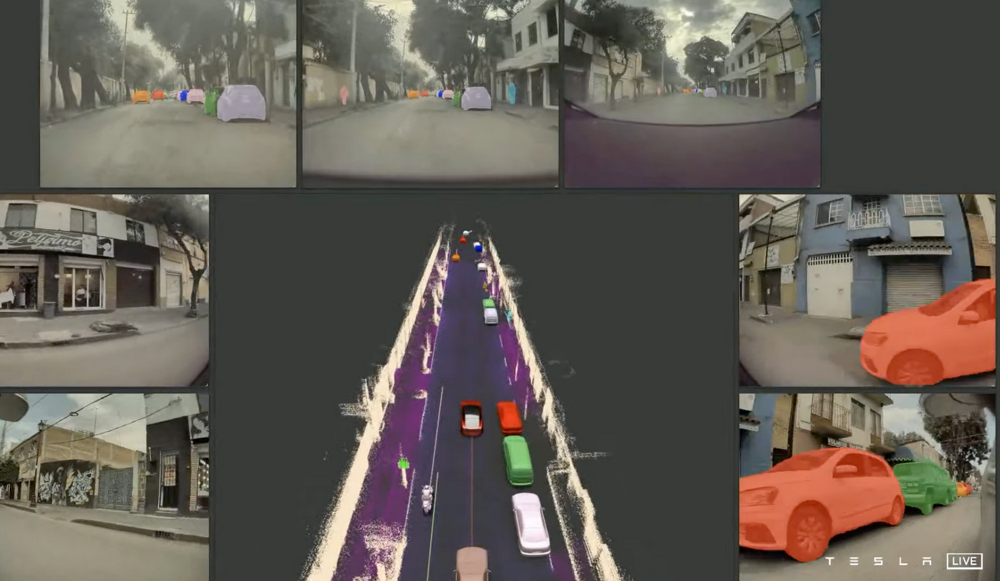

In [2]:

Image(filename="images/tesla_fsd2.png", width=1200)

The idea behind this innovative approach comes from a fun thought experiment. See below. <br>

----------------------------------------------------

Assume we have a robot with only a SONAR and a microphone. No vision, no LIDAR, no RADAR. <br>
Imagine if you sent SONAR in all directions but suddenly the SONAR breaks. The only thing we have left is the microphone to sense our environment. <br>
<br>
So far, we've had Mel Spectrograms and 2D lags of the signal (Takens embeddings). But they tell us nothing about the shape of the sound, hence we're stuck in 2D space with well-defined but conventional methods. <br>

We'll take the 1D signal and create Takens embeddings of it in 100-dimensional space. Then we'll use 3-component PCA to reduce it into a 2D array with 3 components.<br>
These components will be handled like X, Y, and Z coordinates in 3D space.<br>
Now to the magical part, we will slice the shape in 3D space to create 24 slices of of size 24x24 such that we have tensors of shape 24x24x24. <br>

*The magic?*
Take a square block of cheese and cut it into 24 equally sized parts. See below visualization of what we'll do. <br>
Inspiration taken from 3blue1brown and his package *manim*.

In [94]:
%%manim -ql -v WARNING TensorSlicing

TensorSlicing()

#### See below, that is a real cough sample in the dataset. That is one of the samples we do 3D slicing on as visualized above.

In [98]:
cough_sample, sr = librosa.load("cough/c4198cc9-ce73-41ce-9fc8-a38ca9315195.wav", sr=None)
tf = SingleTakensEmbedding(time_delay=1, dimension=100, stride=1, n_jobs=-1, parameters_type="fixed")
pca = PCA(n_components=3)
y = tf.fit_transform(cough_sample)
y_pca = pca.fit_transform(y)

plot_point_cloud(y_pca, plotly_params={"layout":{"width":800, "height":600}})

#### Listen to it if you want =)

In [105]:
Audio(cough_sample, rate=16000)

In [10]:
class ConvBlock3D(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding=2):
        super(ConvBlock3D, self).__init__()
        
        self.conv = nn.Conv3d(in_channels, out_channels, kernel_size, stride, padding)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool3d(kernel_size=2)
        
    def forward(self, x):
        #x = self.conv(x)
        x = self.pool( self.relu( self.conv(x)  ) )
        return x
    
class ConvBlock2D(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding=2):
        super(ConvBlock2D, self).__init__()
        
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2)
        
    def forward(self, x):
        #x = self.conv(x)
        x = self.pool( self.relu( self.conv(x)  ) )
        return x
        
        

class CustomDataset(Dataset):
    
    def __init__(self, mel_path, annotations_file):
        self.mel_path = mel_path
        self.annotations = pd.read_csv(annotations_file)
        
    
    
    def __len__(self):
        return len(self.annotations)
    
    def __getitem__(self, idx):
        mel_sample_path = self._get_mel_path(idx)
        label = self._get_mel_sample_label(idx)
        
        mel = torch.tensor(torch.load(mel_sample_path)).unsqueeze_(0)
        
        return mel.float(), label
        
    
    def _get_mel_path(self, idx):
        
        path = os.path.join(self.mel_path, self.annotations.iloc[idx, 2])
        return path
    
    def _get_mel_sample_label(self, idx):
        return self.annotations.iloc[idx, 1]
        
  
class SingleCNN3D(nn.Module):
    def __init__(self):
        super().__init__()
        
        self.conv1 = ConvBlock3D(1, 32)
        self.conv2 = ConvBlock3D(32, 64)
        self.conv3 = ConvBlock3D(64, 128)
        self.conv4 = ConvBlock3D(128, 256)
        
        self.flatten = nn.Flatten()
        self.linear = nn.Linear(6912, 1)

    def forward(self, x):
        x = self.flatten(  self.conv4( self.conv3( self.conv2( self.conv1( x ) ) )  )) 
        return self.linear(x)

    
        

In [11]:
trainload = CustomDataset("topological_3D_train", "train_full/full_train_labels.csv")
testload = CustomDataset("topological_3D_test", "test_full/full_test_labels.csv")

trainer = DataLoader(trainload, batch_size=16)
tester = DataLoader(testload, batch_size=16)

Confirm that we're working with 3D data

In [183]:
trainload.__getitem__(0)[0].shape

torch.Size([1, 24, 24, 24])

In [12]:
cnn = SingleCNN3D().to("cuda")
initialize_weights(cnn)

In [13]:
loss_fn = nn.BCEWithLogitsLoss()
optim = torch.optim.Adam(cnn.parameters(), lr=0.001)

#### Remember that it is only for demonstration. Use the training files for proper training and cross validation!

In [14]:
results = train_pipeline(model=cnn,
               train_dataloader=trainer,
               test_dataloader=tester,
               optimizer=optim,
               loss_fn=loss_fn,
               epochs=10,
               device="cuda")

Epoch: 0 | Train loss: 16.6207 | Train acc: 0.6067 | Test loss: 0.8789 | Test acc: 0.6604 | Test precision 0.6386 | Test recall 0.7858 | Test F1: 0.7046
Epoch: 1 | Train loss: 0.6911 | Train acc: 0.6642 | Test loss: 0.6476 | Test acc: 0.7163 | Test precision 0.7169 | Test recall 0.7362 | Test F1: 0.7264
Epoch: 2 | Train loss: 0.5905 | Train acc: 0.7178 | Test loss: 0.5642 | Test acc: 0.7279 | Test precision 0.8191 | Test recall 0.6010 | Test F1: 0.6933
Epoch: 3 | Train loss: 0.5848 | Train acc: 0.7419 | Test loss: 0.4869 | Test acc: 0.7717 | Test precision 0.7848 | Test recall 0.7630 | Test F1: 0.7737
Epoch: 4 | Train loss: 0.4635 | Train acc: 0.8000 | Test loss: 0.4426 | Test acc: 0.8096 | Test precision 0.8019 | Test recall 0.8339 | Test F1: 0.8176
Epoch: 5 | Train loss: 0.4297 | Train acc: 0.8232 | Test loss: 0.6478 | Test acc: 0.7508 | Test precision 0.6871 | Test recall 0.9511 | Test F1: 0.7978
Epoch: 6 | Train loss: 0.4412 | Train acc: 0.8175 | Test loss: 0.4080 | Test acc: 0.832

In [89]:
meller = MelSpectrogram(16000, n_fft=1024, hop_length=512, n_mels=64)
tf = SingleTakensEmbedding(time_delay=1, dimension=100, stride=1, n_jobs=-1, parameters_type="fixed") 
pca = PCA(n_components=3)

sample_y, sr = librosa.load("validation/clearing_throat.wav", sr=16000)
sample_y2, sr = librosa.load("validation/snoring_throat_issue.wav", sr=16000)
sample_y3, sr = librosa.load("validation/joe_rogan_podcast_2038.wav", sr=16000)

y_tk = tf.fit_transform( sample_y )
y_tk2 = tf.fit_transform( sample_y2 )
y_tk3 = tf.fit_transform( sample_y3 )

y_tk = pca.fit_transform(y_tk)
y_tk2 = pca.fit_transform(y_tk2)
y_tk3 = pca.fit_transform(y_tk3)

y_tensor = create_3d_tensor_from_pca(y_tk, shape=(24,24,24))
y_tensor = torch.tensor(y_tensor)[None, None,:,:,:].float().to("cuda")

y_tensor2 = create_3d_tensor_from_pca(y_tk2, shape=(24,24,24))
y_tensor2 = torch.tensor(y_tensor2)[None, None,:,:,:].float().to("cuda")

y_tensor3 = create_3d_tensor_from_pca(y_tk3, shape=(24,24,24))
y_tensor3 = torch.tensor(y_tensor3)[None, None,:,:,:].float().to("cuda")


In [90]:
print("Prediction sample 'clearing_throat': {} probability being cough".format(round(1 / (1+torch.exp(-cnn(y_tensor))).cpu().detach().numpy()[0][0], 2)))
print("Prediction sample 'snoring_throat_issue': {} probability being cough".format(round(1 / (1+torch.exp(-cnn(y_tensor2))).cpu().detach().numpy()[0][0], 2)))
print("Prediction sample 'joe_rogan_podcast_2038': {} probability being cough".format(round(1 / (1+torch.exp(-cnn(y_tensor3))).cpu().detach().numpy()[0][0], 2)))

Prediction sample 'clearing_throat': 0.56 probability being cough
Prediction sample 'snoring_throat_issue': 0.55 probability being cough
Prediction sample 'joe_rogan_podcast_2038': 0.41 probability being cough


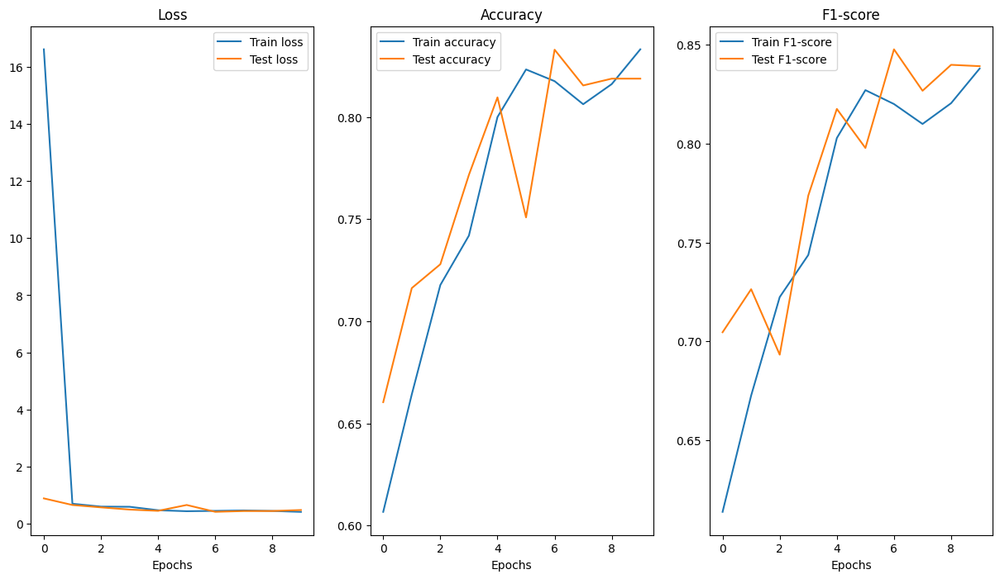

In [15]:
plt.figure(figsize=(15, 8))

plt.subplot(1,3,1)

r = 10

plt.plot(range(r), results["train_loss"], label="Train loss")
plt.plot(range(r), results["test_loss"], label="Test loss")
plt.title("Loss")
plt.xlabel("Epochs")
plt.legend()

plt.subplot(1,3,2)
plt.plot(range(r), results["train_acc"], label="Train accuracy")
plt.plot(range(r), results["test_acc"], label="Test accuracy")
plt.title("Accuracy")
plt.xlabel("Epochs")
plt.legend()


plt.subplot(1,3,3)
plt.plot(range(r), results["train_f1"], label="Train F1-score")
plt.plot(range(r), results["test_f1"], label="Test F1-score")
plt.title("F1-score")
plt.xlabel("Epochs")
plt.legend()

In [16]:
for i in range(len(trainload)):
    if trainload._get_mel_path(i).endswith("1-18755-B-4.pt"):
        print(trainload._get_mel_path(i), i)

topological_3D_train\1-18755-B-4.pt 475
topological_3D_train\noise_1-18755-B-4.pt 3261


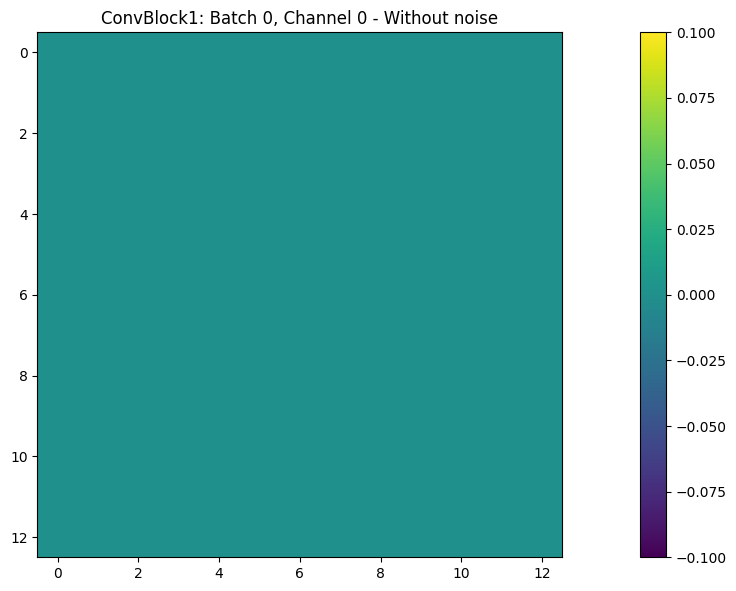

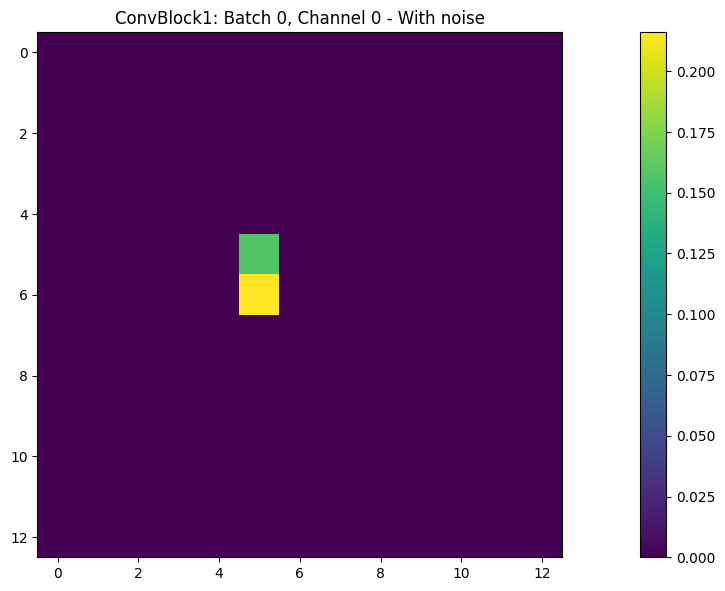

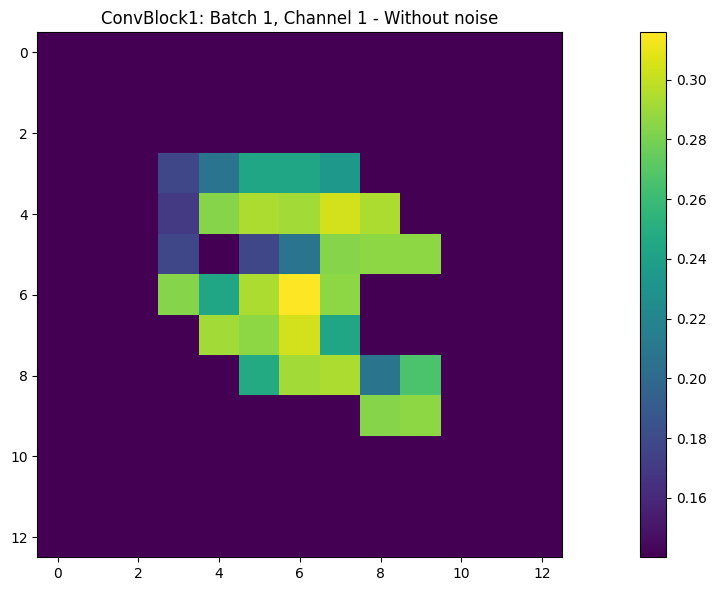

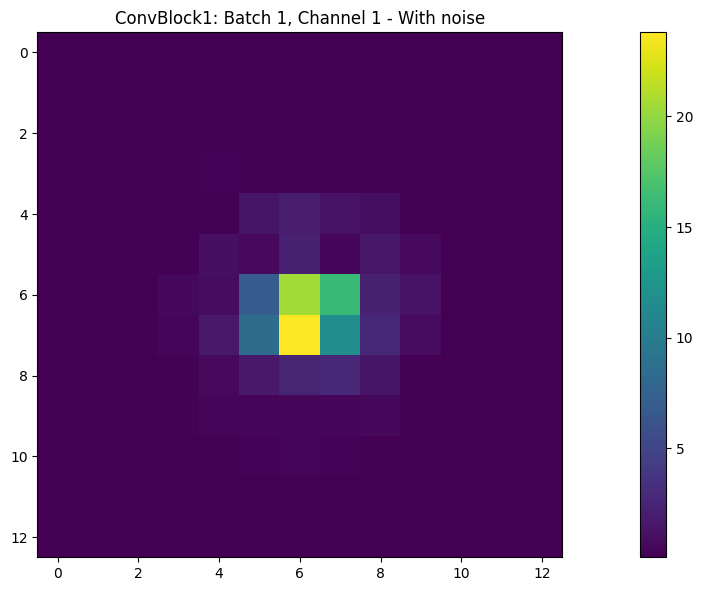

In [18]:
mel_sample = trainload.__getitem__(475)[0]      # Without noise injection
mel_sample_noise = trainload.__getitem__(3261)[0] # With noise injection

output = cnn.conv1(mel_sample.to("cuda"))
output2 = cnn.conv1(mel_sample_noise.to("cuda"))

# Loop over the batch dimension
for i in range(2):
    # Loop over the channels
    for j in range(1):
        fig = plt.figure(figsize=(20,15))
        fig.add_subplot(2, 1, 1)
        plt.imshow(output[i,j].detach().cpu().numpy().T, cmap='viridis')
        plt.colorbar()
        plt.title(f"ConvBlock1: Batch {i}, Channel {i} - Without noise")

        fig = plt.figure(figsize=(20,15))
        fig.add_subplot(2,1,2)
        plt.imshow(output2[i,j].detach().cpu().numpy().T, cmap='viridis')
        plt.colorbar()
        plt.title(f"ConvBlock1: Batch {i}, Channel {i} - With noise")
        plt.show()

# Hybrid CNN with 3D and 2D input

In [24]:
class HybridCNN(nn.Module):
    def __init__(self):
        super(HybridCNN, self).__init__()
        
        # 3D CNN pathway
        self.conv3d_1 = ConvBlock3D(1, 128)
        self.conv3d_2 = ConvBlock3D(128, 256)
        self.drop3d_1 = nn.Dropout3d(.5)
        self.batchnorm3d = nn.BatchNorm3d(256)
        self.conv3d_3 = ConvBlock3D(256, 256)
        self.conv3d_4 = ConvBlock3D(256, 512)
        self.drop3d_2 = nn.Dropout3d(.5)
        self.batchnorm3d_2 = nn.BatchNorm3d(512)
        self.conv3d_5 = ConvBlock3D(512, 512)
        self.flat3d = nn.Flatten()
        
        # 2D CNN pathway
        self.conv2d_1 = ConvBlock2D(1, 32)
        self.conv2d_2 = ConvBlock2D(32, 64)
        self.drop2d_1 = nn.Dropout2d(0.5)
        self.batchnorm2d = nn.BatchNorm2d(64)
        self.conv2d_3 = ConvBlock2D(64, 256)
        self.conv2d_4 = ConvBlock2D(256, 512)
        self.drop2d_2 = nn.Dropout2d(0.5)
        self.batchnorm2d_2 = nn.BatchNorm2d(512)
        self.conv2d_5 = ConvBlock2D(512, 512)
        self.flat2d = nn.Flatten()
        
        # Fully connected layers after merging
        self.fc1 = nn.Linear(in_features=(16384), out_features=32)  # dim1, dim2, ... need to be determined based on previous layer shapes
        self.fc2 = nn.Linear(32, 1)  # num_classes is the number of output classes or nodes
        
    def forward(self, x3d, x2d):
        # 3D CNN pathway
        x3d = self.batchnorm3d( self.drop3d_1( self.conv3d_2( self.conv3d_1(x3d) ) ) )
        x3d = self.batchnorm3d_2( self.drop3d_2( self.conv3d_4( self.conv3d_3( x3d  ) ) ) )
        x3d = self.flat3d( self.conv3d_5( x3d )) 

        
        # 2D CNN pathway
        x2d = self.batchnorm2d( self.drop2d_1( self.conv2d_2( self.conv2d_1(x2d) ) ) )
        x2d = self.batchnorm2d_2( self.drop2d_2( self.conv2d_4( self.conv2d_3( x2d )  ) ) )
        x2d = self.flat2d( self.conv2d_5( x2d ) ) 

        
        # Merge
        x = torch.cat((x3d, x2d), dim=1)
        
        # Fully connected layers
        x = self.fc1(x)
        x = self.fc2(x)
        
        return x

In [31]:
class MultiInputData(Dataset):
    
    def __init__(self, topo_path, melspec_path, annotations_file):
        self.topo_path = topo_path
        self.melspec_path = melspec_path
        self.annotations = pd.read_csv(annotations_file)
        
    
    
    def __len__(self):
        return len(self.annotations)
    
    def __getitem__(self, idx):
        topo_3d, mel_spec = self._get_topo_path(idx), self._get_spectro_path(idx)
        label = self._get_audio_sample_label(idx)
        
        topo = torch.tensor(torch.load(topo_3d)).unsqueeze_(0)
        mel = torch.tensor(torch.load(mel_spec)).unsqueeze_(0)
        
        return topo.float(), mel.float(), label
        
    
    def _get_spectro_path(self, idx):
        path = os.path.join(self.melspec_path, self.annotations.iloc[idx, 2])
        return path
    
    def _get_topo_path(self, idx):
        
        path = os.path.join(self.topo_path, self.annotations.iloc[idx, 2])
        return path
    
    def _get_audio_sample_label(self, idx):
        return self.annotations.iloc[idx, 1]

In [32]:
trainload = MultiInputData("topological_3D_train", "train_full", "train_full/full_train_labels.csv")
testload = MultiInputData("topological_3D_test", "test_full", "test_full/full_test_labels.csv")

trainer = DataLoader(trainload, batch_size=16)
tester = DataLoader(testload, batch_size=16)

In [21]:
trainload.__getitem__(0)[0].shape , trainload.__getitem__(0)[1].shape   # The first is the 3D tensor point cloud of the audio and the second is the 2D Mel Spectrogram

(torch.Size([1, 24, 24, 24]), torch.Size([1, 64, 219]))

In [46]:
hybrid_cnn = HybridCNN().to("cuda")
initialize_weights(hybrid_cnn)

loss_fn = nn.BCEWithLogitsLoss()
optim = torch.optim.Adam(hybrid_cnn.parameters(), lr=0.01, weight_decay=1e-5)
# optim = torch.optim.SGD(cnn.parameters(), lr=0.01, momentum=0.9)
scheduler = torch.optim.lr_scheduler.ExponentialLR(optim, gamma=0.9)

#### Hybrid CNN with 17.5 million parameters

In [50]:
from torchinfo import summary
summary(hybrid_cnn, input_size=[(1,1,24,24,24), (1,1,64,219)])

Layer (type:depth-idx)                   Output Shape              Param #
HybridCNN                                [1, 1]                    --
├─ConvBlock3D: 1-1                       [1, 128, 13, 13, 13]      --
│    └─Conv3d: 2-1                       [1, 128, 26, 26, 26]      3,584
│    └─ReLU: 2-2                         [1, 128, 26, 26, 26]      --
│    └─MaxPool3d: 2-3                    [1, 128, 13, 13, 13]      --
├─ConvBlock3D: 1-2                       [1, 256, 7, 7, 7]         --
│    └─Conv3d: 2-4                       [1, 256, 15, 15, 15]      884,992
│    └─ReLU: 2-5                         [1, 256, 15, 15, 15]      --
│    └─MaxPool3d: 2-6                    [1, 256, 7, 7, 7]         --
├─Dropout3d: 1-3                         [1, 256, 7, 7, 7]         --
├─BatchNorm3d: 1-4                       [1, 256, 7, 7, 7]         512
├─ConvBlock3D: 1-5                       [1, 256, 4, 4, 4]         --
│    └─Conv3d: 2-7                       [1, 256, 9, 9, 9]         1,769,728

In [47]:
results = train_pipeline_hybrid(model=hybrid_cnn,
               train_dataloader=trainer,
               test_dataloader=tester,
               optimizer=optim,
               loss_fn=loss_fn,
               epochs=10,
               device="cuda")

Epoch: 0 | Train loss: 16.8841 | Train acc: 0.7822 | Test loss: 1681.0609 | Test acc: 0.7346 | Test precision 0.8887 | Test recall 0.5529 | Test F1: 0.6817
Epoch: 1 | Train loss: 0.4092 | Train acc: 0.8462 | Test loss: 1053.0012 | Test acc: 0.7246 | Test precision 0.9067 | Test recall 0.5147 | Test F1: 0.6566
Epoch: 2 | Train loss: 0.4057 | Train acc: 0.8478 | Test loss: 771.9782 | Test acc: 0.8242 | Test precision 0.9278 | Test recall 0.7117 | Test F1: 0.8055
Epoch: 3 | Train loss: 0.3479 | Train acc: 0.8587 | Test loss: 979.6129 | Test acc: 0.8596 | Test precision 0.9355 | Test recall 0.7793 | Test F1: 0.8503
Epoch: 4 | Train loss: 0.3169 | Train acc: 0.8755 | Test loss: 689.4791 | Test acc: 0.8529 | Test precision 0.9235 | Test recall 0.7769 | Test F1: 0.8439
Epoch: 5 | Train loss: 0.3058 | Train acc: 0.8754 | Test loss: 748.9471 | Test acc: 0.8371 | Test precision 0.9614 | Test recall 0.7101 | Test F1: 0.8169
Epoch: 6 | Train loss: 0.2800 | Train acc: 0.8917 | Test loss: 447.3493 |

In [85]:
meller = MelSpectrogram(16000, n_fft=1024, hop_length=512, n_mels=64)
tf = SingleTakensEmbedding(time_delay=1, dimension=100, stride=1, n_jobs=-1, parameters_type="fixed") 
pca = PCA(n_components=3)

sample_y, sr = librosa.load("validation/clearing_throat.wav", sr=16000)
sample_y2, sr = librosa.load("validation/snoring_throat_issue.wav", sr=16000)
sample_y3, sr = librosa.load("validation/joe_rogan_podcast_2038.wav", sr=16000)

sample_mel = meller(torch.tensor(sample_y))
sample_mel = torch.tensor(sample_mel)[None, None,:,:].to("cuda")

sample_mel2 = meller(torch.tensor(sample_y2))
sample_mel2 = torch.tensor(sample_mel2)[None, None,:,:].to("cuda")

sample_mel3 = meller(torch.tensor(sample_y3))
sample_mel3 = torch.tensor(sample_mel3)[None, None,:,:].to("cuda")


y_tk = tf.fit_transform( sample_y )
y_tk2 = tf.fit_transform( sample_y2 )
y_tk3 = tf.fit_transform( sample_y3 )

y_tk = pca.fit_transform(y_tk)
y_tk2 = pca.fit_transform(y_tk2)
y_tk3 = pca.fit_transform(y_tk3)

y_tensor = create_3d_tensor_from_pca(y_tk, shape=(24,24,24))
y_tensor = torch.tensor(y_tensor)[None, None,:,:,:].float().to("cuda")

y_tensor2 = create_3d_tensor_from_pca(y_tk2, shape=(24,24,24))
y_tensor2 = torch.tensor(y_tensor2)[None, None,:,:,:].float().to("cuda")

y_tensor3 = create_3d_tensor_from_pca(y_tk3, shape=(24,24,24))
y_tensor3 = torch.tensor(y_tensor3)[None, None,:,:,:].float().to("cuda")

In [88]:
print("Prediction sample 'clearing_throat': {} probability being cough".format(round(1 / (1+torch.exp(-hybrid_cnn(y_tensor, sample_mel))).cpu().detach().numpy()[0][0], 2)))
print("Prediction sample 'snoring_throat_issue': {} probability being cough".format(round(1 / (1+torch.exp(-hybrid_cnn(y_tensor2, sample_mel2))).cpu().detach().numpy()[0][0], 2)))
print("Prediction sample 'joe_rogan_podcast_2038': {} probability being cough".format(round(1 / (1+torch.exp(-hybrid_cnn(y_tensor3, sample_mel3))).cpu().detach().numpy()[0][0], 2)))

Prediction sample 'clearing_throat': 0.21 probability being cough
Prediction sample 'snoring_throat_issue': 0.97 probability being cough
Prediction sample 'joe_rogan_podcast_2038': 0.88 probability being cough
